# ImageForensicsOSN results analysis
Small notebook to compute the splicing analysis results for ImageForensicsOSN.
This detector corresponds to the entry [r1-r3] of the rebuttal.

## Libraries import

In [1]:
import os
import glob
import sys
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import PIL.Image as Image
import cv2
from tqdm.notebook import tqdm
mpl.use("pgf")
pgf_with_rc_fonts = {
    "font.family": "serif",
    "font.serif": [],                   # use latex default serif font
    "font.sans-serif": ["DejaVu Sans"], # use a specific sans-serif font
}
mpl.rcParams.update(pgf_with_rc_fonts)
import matplotlib.pyplot as plt
fontsize = 18
plt.rc('text', usetex=True)
plt.rc('font', family='sans',size=fontsize)
plt.rc('legend',fontsize=fontsize)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)
plt.rc('axes',labelsize=fontsize,titlesize=fontsize)
plt.rc('lines',linewidth=2)
%matplotlib inline
import warnings

warnings.filterwarnings('ignore')

## Execution params

In [2]:
results_dir = '/nas/public/exchange/JPEG-AI/code/results/ImageForensicsOSN'
results_root = '/nas/public/exchange/JPEG-AI/code'

## Load results

In [3]:
results_df = pd.read_csv(os.path.join(results_dir, 'splicing_localization_metrics.csv'), index_col=[0, 1, 2, 3])
results_df.index.rename(['Type', 'Dataset', 'Quality', 'Path'], inplace=True)
#results_df.rename(index={'NaN':'NA'}, level='Quality', inplace=True)
results_df.index = pd.MultiIndex.from_frame(
        results_df.index.to_frame().fillna('Uncompressed')
    )
results_df

AUC  \
Type          Dataset Quality      Path                                                           
Uncompressed  CASIA1  Uncompressed /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.883587   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.993787   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.999696   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.981179   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.530264   
...                                                                                         ...   
Double JPEGAI DSO-1   2.0          /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.839622   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.865319   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.931477   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.947129   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.958721   

                                                                                         BA@0.5  \
Type          Dataset Quality      Path                                                           
Uncompressed  CASIA1  Uncompressed /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.554399   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.689924   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.980662   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.500000   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.490718   
...                                                                                         ...   
Double JPEGAI DSO-1   2.0          /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.692263   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.684480   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.665523   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.790162   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.811356   

                                                                                        BA best  \
Type          Dataset Quality      Path                                                           
Uncompressed  CASIA1  Uncompressed /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.793217   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.984941   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.992884   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.944835   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.559598   
...                                                                                         ...   
Double JPEGAI DSO-1   2.0          /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.793169   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.820419   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.900331   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.895398   
                                   /nas/public/exchange/JPEG-AI/data/TEST_SPLICED/...  0.923053   

                                                                                         F1@0.5  \
Type          Dataset Quality      Path                                                           
Uncompressed  CASIA1  Uncompre

## Let's re-organize and see the mean metrics

In [5]:
# Let's select the simple uncompressed VS JPEGAI case
mean_df = results_df.groupby(['Type', 'Quality']).mean()
mean_df = mean_df.loc[['Uncompressed', 'JPEGAI']].droplevel(0).transpose()
mean_df.columns.name = ''
mean_df.index = mean_df.index.map(lambda x: str(x))
mean_df = pd.concat({'ImageForensicsOSN': mean_df}, names=['Detector', 'Metric'])
mean_df


Uncompressed      0.12      0.25       0.5  \
Detector          Metric                                                
ImageForensicsOSN AUC          0.855504  0.710540  0.733744  0.795295   
                  BA@0.5       0.726517  0.602443  0.624512  0.675360   
                  BA best      0.848173  0.730609  0.753827  0.801519   
                  F1@0.5       0.555879  0.282128  0.335829  0.438423   
                  F1 best      0.687890  0.408416  0.466423  0.578560   
                  FPR@0.5      0.062713  0.181096  0.109729  0.072017   

                               0.75       1.0       2.0  
Detector          Metric                                 
ImageForensicsOSN AUC      0.800399  0.841076  0.838575  
                  BA@0.5   0.681841  0.713590  0.712154  
                  BA best  0.806570  0.837935  0.834014  
                  F1@0.5   0.438191  0.518215  0.507292  
                  F1 best  0.584003  0.647422  0.639204  
                  FPR@0.5  0.080697  0.049683  0.052721

### Let's print it

In [6]:
print(mean_df.to_latex(float_format='%.2f'))

\begin{tabular}{llrrrrrrr}
\toprule
 &  & Uncompressed & 0.120000 & 0.250000 & 0.500000 & 0.750000 & 1.000000 & 2.000000 \\
Detector & Metric &  &  &  &  &  &  &  \\
\midrule
\multirow[t]{6}{*}{ImageForensicsOSN} & AUC & 0.86 & 0.71 & 0.73 & 0.80 & 0.80 & 0.84 & 0.84 \\
 & BA@0.5 & 0.73 & 0.60 & 0.62 & 0.68 & 0.68 & 0.71 & 0.71 \\
 & BA best & 0.85 & 0.73 & 0.75 & 0.80 & 0.81 & 0.84 & 0.83 \\
 & F1@0.5 & 0.56 & 0.28 & 0.34 & 0.44 & 0.44 & 0.52 & 0.51 \\
 & F1 best & 0.69 & 0.41 & 0.47 & 0.58 & 0.58 & 0.65 & 0.64 \\
 & FPR@0.5 & 0.06 & 0.18 & 0.11 & 0.07 & 0.08 & 0.05 & 0.05 \\
\cline{1-9}
\bottomrule
\end{tabular}



### What about the effect of JPEG?

In [7]:
# Let's select the simple uncompressed VS JPEGAI case
mean_df = results_df.groupby(['Type', 'Quality']).mean()
mean_df = mean_df.loc[['Uncompressed', 'JPEG']].droplevel(0).transpose()
mean_df.columns.name = ''
mean_df.index = mean_df.index.map(lambda x: str(x))
mean_df = pd.concat({'ImageForensicsOSN': mean_df}, names=['Detector', 'Metric'])
mean_df


Uncompressed      65.0      75.0      85.0  \
Detector          Metric                                                
ImageForensicsOSN AUC          0.855504  0.772393  0.784156  0.798820   
                  BA@0.5       0.726517  0.647392  0.654668  0.666982   
                  BA best      0.848173  0.775535  0.783774  0.795182   
                  F1@0.5       0.555879  0.475818  0.479590  0.497078   
                  F1 best      0.687890  0.615430  0.626162  0.644517   
                  FPR@0.5      0.062713  0.115317  0.113854  0.109901   

                               95.0  
Detector          Metric             
ImageForensicsOSN AUC      0.820728  
                  BA@0.5   0.690722  
                  BA best  0.814208  
                  F1@0.5   0.528099  
                  F1 best  0.678160  
                  FPR@0.5  0.105561

### Let's consider the DSO-1 dataset in particular

In [8]:
# Let's select the simple uncompressed VS JPEGAI case
mean_df = results_df.loc[pd.IndexSlice[:, 'DSO-1', :, :]].groupby(['Type', 'Quality']).mean()
mean_df = mean_df.loc[['Uncompressed', 'JPEGAI']].droplevel(0).transpose()
mean_df.columns.name = ''
mean_df.index = mean_df.index.map(lambda x: str(x))
mean_df = pd.concat({'ImageForensicsOSN': mean_df}, names=['Detector', 'Metric'])
mean_df


Uncompressed      0.12      0.25       0.5  \
Detector          Metric                                                
ImageForensicsOSN AUC          0.857738  0.680523  0.739449  0.795120   
                  BA@0.5       0.727522  0.630468  0.664225  0.706050   
                  BA best      0.821434  0.675871  0.719736  0.764364   
                  F1@0.5       0.468483  0.302618  0.335191  0.388028   
                  F1 best      0.615848  0.351143  0.399255  0.484921   
                  FPR@0.5      0.086462  0.313741  0.271342  0.192324   

                               0.75       1.0       2.0  
Detector          Metric                                 
ImageForensicsOSN AUC      0.794657  0.835920  0.834868  
                  BA@0.5   0.707346  0.726184  0.725512  
                  BA best  0.763963  0.799825  0.800149  
                  F1@0.5   0.389158  0.437439  0.435897  
                  F1 best  0.489149  0.570224  0.568279  
                  FPR@0.5  0.192457  0.123427  0.130375

In [9]:
# Let's select the simple uncompressed VS JPEG case
mean_df = results_df.loc[pd.IndexSlice[:, 'DSO-1', :, :]].groupby(['Type', 'Quality']).mean()
mean_df = mean_df.loc[['Uncompressed', 'JPEG']].droplevel(0).transpose()
mean_df.columns.name = ''
mean_df.index = mean_df.index.map(lambda x: str(x))
mean_df = pd.concat({'ImageForensicsOSN': mean_df}, names=['Detector', 'Metric'])
mean_df


Uncompressed      65.0      75.0      85.0  \
Detector          Metric                                                
ImageForensicsOSN AUC          0.857738  0.831114  0.840972  0.852393   
                  BA@0.5       0.727522  0.695524  0.705371  0.711773   
                  BA best      0.821434  0.802014  0.809670  0.819698   
                  F1@0.5       0.468483  0.438407  0.448915  0.460884   
                  F1 best      0.615848  0.572460  0.588203  0.601541   
                  FPR@0.5      0.086462  0.060661  0.067618  0.073614   

                               95.0  
Detector          Metric             
ImageForensicsOSN AUC      0.872302  
                  BA@0.5   0.725264  
                  BA best  0.833681  
                  F1@0.5   0.488269  
                  F1 best  0.633562  
                  FPR@0.5  0.073416

In [10]:
# Let's print it
print(mean_df.to_latex(float_format='%.2f'))

\begin{tabular}{llrrrrr}
\toprule
 &  & Uncompressed & 65.000000 & 75.000000 & 85.000000 & 95.000000 \\
Detector & Metric &  &  &  &  &  \\
\midrule
\multirow[t]{6}{*}{ImageForensicsOSN} & AUC & 0.86 & 0.83 & 0.84 & 0.85 & 0.87 \\
 & BA@0.5 & 0.73 & 0.70 & 0.71 & 0.71 & 0.73 \\
 & BA best & 0.82 & 0.80 & 0.81 & 0.82 & 0.83 \\
 & F1@0.5 & 0.47 & 0.44 & 0.45 & 0.46 & 0.49 \\
 & F1 best & 0.62 & 0.57 & 0.59 & 0.60 & 0.63 \\
 & FPR@0.5 & 0.09 & 0.06 & 0.07 & 0.07 & 0.07 \\
\cline{1-7}
\bottomrule
\end{tabular}



## Let's see some examples of masks from DSO-1 

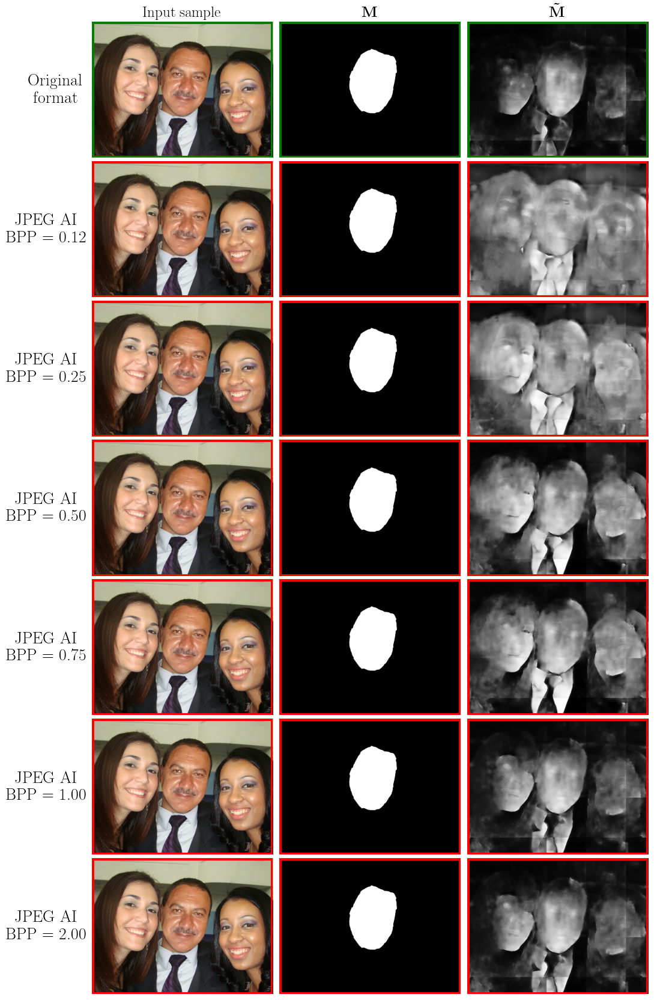

In [11]:
import matplotlib.patches as patches

unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
filename = 'splicing-99'
samples = jpegai_df.loc[jpegai_df['filename']==filename]
fig, axs = plt.subplots(len(samples['target_bpp'].unique())+1, 3, figsize=(12, 3*(len(samples['target_bpp'].unique())+1)))

# Plot everything
for idx, bpp in enumerate(sorted(samples['target_bpp'].unique())):
    # Load sample
    row = samples.loc[samples['target_bpp']==bpp]
    img = Image.open(row.index.values[0][1])
    gt = Image.open(row['gt'].item()).convert('L')
    gt = np.array(gt) < 0.1  # convert as DSO-1 masks are swapped
    mask = np.load(os.path.join(results_root, row['mask_path'].item()))
    axs[idx+1][0].imshow(img), axs[idx+1][1].imshow(gt, cmap='gray'), axs[idx+1][2].imshow(mask, cmap='gray')
    axs[idx+1][0].axis('off'), axs[idx+1][1].axis('off'), axs[idx+1][2].axis('off')
    
    # Add red contour
    for ax in axs[idx+1]:
        rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
    
    # Add text
    axs[idx+1][0].text(-0.25, 0.5, f'JPEG AI\n BPP = {bpp:.2f}', transform=axs[idx+1][0].transAxes, fontsize=20, va='center', ha='center')

# Load original sample and mask
row = unc_df.loc[unc_df['filename']==filename]
img = Image.open(row.index.values[0][1])
mask = np.load(os.path.join(results_root, row['mask_path'].item()))
axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

# Add green contour to the first row
for ax in axs[0]:
    rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

# Add text to the first row
axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

# Adjust the space between rows 
#fig.tight_layout()
fig.subplots_adjust(hspace=0.025, wspace=0.025)
plt.show()


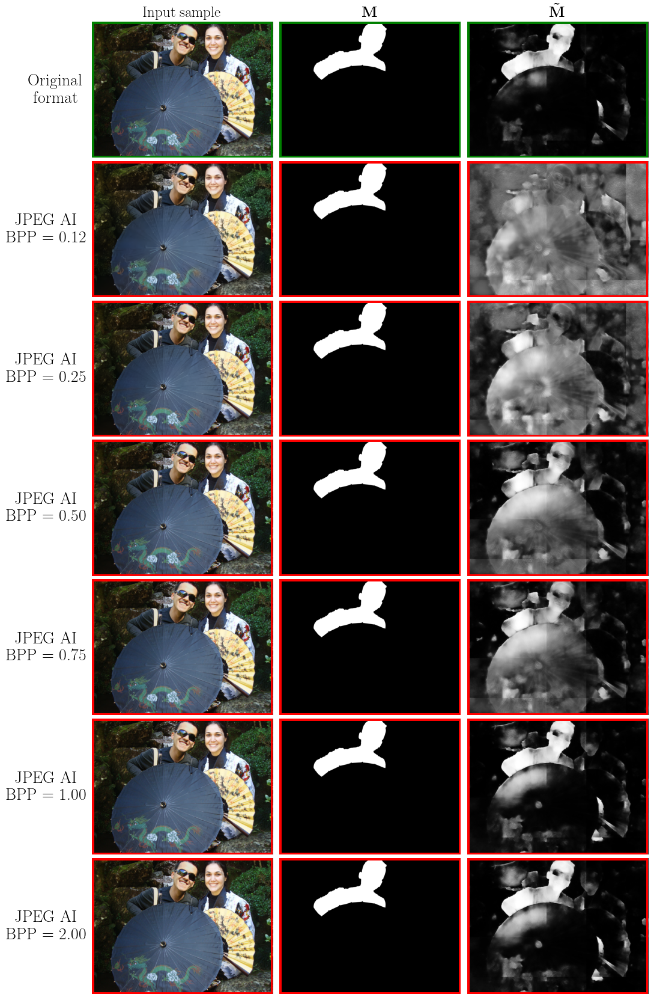

In [12]:
import matplotlib.patches as patches

unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
filename = 'splicing-34'
samples = jpegai_df.loc[jpegai_df['filename']==filename]
fig, axs = plt.subplots(len(samples['target_bpp'].unique())+1, 3, figsize=(12, 3*(len(samples['target_bpp'].unique())+1)))

# Plot everything
for idx, bpp in enumerate(sorted(samples['target_bpp'].unique())):
    # Load sample
    row = samples.loc[samples['target_bpp']==bpp]
    img = Image.open(row.index.values[0][1])
    gt = Image.open(row['gt'].item()).convert('L')
    gt = np.array(gt) < 0.1  # convert as DSO-1 masks are swapped
    mask = np.load(os.path.join(results_root, row['mask_path'].item()))
    axs[idx+1][0].imshow(img), axs[idx+1][1].imshow(gt, cmap='gray'), axs[idx+1][2].imshow(mask, cmap='gray')
    axs[idx+1][0].axis('off'), axs[idx+1][1].axis('off'), axs[idx+1][2].axis('off')
    
    # Add red contour
    for ax in axs[idx+1]:
        rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
    
    # Add text
    axs[idx+1][0].text(-0.25, 0.5, f'JPEG AI\n BPP = {bpp:.2f}', transform=axs[idx+1][0].transAxes, fontsize=20, va='center', ha='center')

# Load original sample and mask
row = unc_df.loc[unc_df['filename']==filename]
img = Image.open(row.index.values[0][1])
mask = np.load(os.path.join(results_root, row['mask_path'].item()))
axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

# Add green contour to the first row
for ax in axs[0]:
    rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

# Add text to the first row
axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

# Adjust the space between rows 
#fig.tight_layout()
fig.subplots_adjust(hspace=0.025, wspace=0.025)
plt.show()


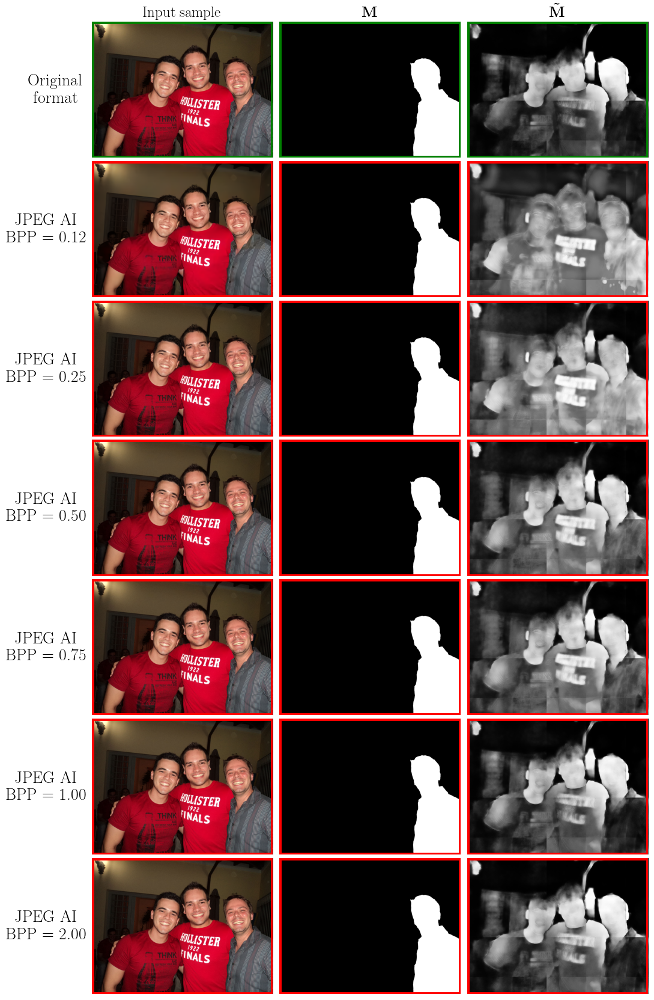

In [13]:
import matplotlib.patches as patches

unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
filename = 'splicing-12'
samples = jpegai_df.loc[jpegai_df['filename']==filename]
fig, axs = plt.subplots(len(samples['target_bpp'].unique())+1, 3, figsize=(12, 3*(len(samples['target_bpp'].unique())+1)))

# Plot everything
for idx, bpp in enumerate(sorted(samples['target_bpp'].unique())):
    # Load sample
    row = samples.loc[samples['target_bpp']==bpp]
    img = Image.open(row.index.values[0][1])
    gt = Image.open(row['gt'].item()).convert('L')
    gt = np.array(gt) < 0.1  # convert as DSO-1 masks are swapped
    mask = np.load(os.path.join(results_root, row['mask_path'].item()))
    axs[idx+1][0].imshow(img), axs[idx+1][1].imshow(gt, cmap='gray'), axs[idx+1][2].imshow(mask, cmap='gray')
    axs[idx+1][0].axis('off'), axs[idx+1][1].axis('off'), axs[idx+1][2].axis('off')
    
    # Add red contour
    for ax in axs[idx+1]:
        rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
    
    # Add text
    axs[idx+1][0].text(-0.25, 0.5, f'JPEG AI\n BPP = {bpp:.2f}', transform=axs[idx+1][0].transAxes, fontsize=20, va='center', ha='center')

# Load original sample and mask
row = unc_df.loc[unc_df['filename']==filename]
img = Image.open(row.index.values[0][1])
mask = np.load(os.path.join(results_root, row['mask_path'].item()))
axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

# Add green contour to the first row
for ax in axs[0]:
    rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

# Add text to the first row
axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

# Adjust the space between rows 
#fig.tight_layout()
fig.subplots_adjust(hspace=0.025, wspace=0.025)
plt.show()


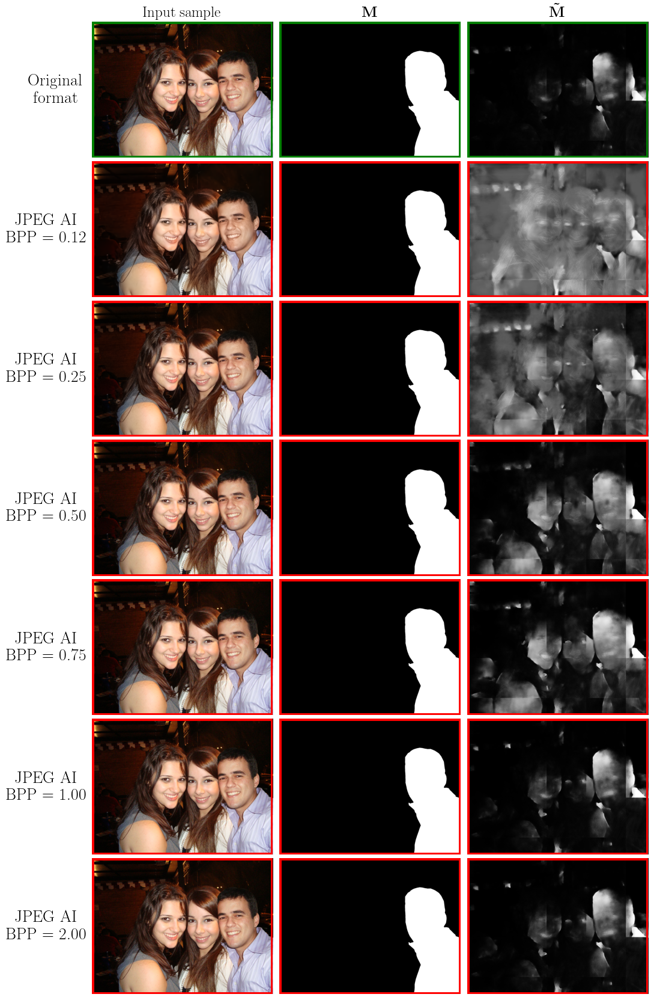

In [14]:
import matplotlib.patches as patches

unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
filename = 'splicing-71'
samples = jpegai_df.loc[jpegai_df['filename']==filename]
fig, axs = plt.subplots(len(samples['target_bpp'].unique())+1, 3, figsize=(12, 3*(len(samples['target_bpp'].unique())+1)))

# Plot everything
for idx, bpp in enumerate(sorted(samples['target_bpp'].unique())):
    # Load sample
    row = samples.loc[samples['target_bpp']==bpp]
    img = Image.open(row.index.values[0][1])
    gt = Image.open(row['gt'].item()).convert('L')
    gt = np.array(gt) < 0.1  # convert as DSO-1 masks are swapped
    mask = np.load(os.path.join(results_root, row['mask_path'].item()))
    axs[idx+1][0].imshow(img), axs[idx+1][1].imshow(gt, cmap='gray'), axs[idx+1][2].imshow(mask, cmap='gray')
    axs[idx+1][0].axis('off'), axs[idx+1][1].axis('off'), axs[idx+1][2].axis('off')
    
    # Add red contour
    for ax in axs[idx+1]:
        rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
    
    # Add text
    axs[idx+1][0].text(-0.25, 0.5, f'JPEG AI\n BPP = {bpp:.2f}', transform=axs[idx+1][0].transAxes, fontsize=20, va='center', ha='center')

# Load original sample and mask
row = unc_df.loc[unc_df['filename']==filename]
img = Image.open(row.index.values[0][1])
mask = np.load(os.path.join(results_root, row['mask_path'].item()))
axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

# Add green contour to the first row
for ax in axs[0]:
    rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

# Add text to the first row
axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

# Adjust the space between rows 
#fig.tight_layout()
fig.subplots_adjust(hspace=0.025, wspace=0.025)
plt.show()


### What about doube JPEG AI compression?
We tested just the DSO-1 for reference.

In [15]:
# Select and separe the different conditions
dso1 = results_df.loc[pd.IndexSlice[:, 'DSO-1', :, :]]
unc = dso1.loc['Uncompressed']
jpegai = dso1.loc['JPEGAI']
djpegai = dso1.loc['Double JPEGAI']
# Add source BPP info on djpegai
djpegai['Source BPP'] = [float(path.split('source_bpp-')[1].split('.')[0])/100 if 'source_bpp' in path else 'None' for path in djpegai.index.get_level_values('Path')]
djpegai.set_index('Source BPP', append=True, inplace=True)
# Compute the mean for each
unc = unc.groupby(['Quality']).mean()
jpegai = jpegai.groupby(['Quality']).mean()
djpegai = djpegai.groupby(['Quality', 'Source BPP']).mean()

# Prepare a separate DataFrame for each quality BPP
for quality in [0.12, 2.00]:
    q_djpegai = djpegai.loc[quality].transpose()
    q_djpegai.columns.name = ''
    q_djpegai.rename(columns=lambda x: f'MC {x}-{quality}', inplace=True)
    q_djpegai = q_djpegai.join(unc.transpose())
    q_jpegai = jpegai.loc[quality].transpose()
    q_jpegai.name = f'SC {quality}'
    q_djpegai = q_djpegai.join(q_jpegai)
    q_djpegai = q_djpegai[['Uncompressed', f'SC {quality}', f'MC 0.12-{quality}', f'MC 0.25-{quality}', f'MC 0.5-{quality}', f'MC 0.75-{quality}', f'MC 1.0-{quality}', f'MC 2.0-{quality}']]
    display_df = q_djpegai.style.set_caption(f"Results for double JPEG AI compression BPP = {quality}. SC = Single compression, MC = Mixed compression")
    display_df = display_df.format(lambda x: f"{x:.4f}")
    display_df = display_df.format_index(lambda x: str(x), axis=1)
    display(display_df)

,Uncompressed,SC 0.12,MC 0.12-0.12,MC 0.25-0.12,MC 0.5-0.12,MC 0.75-0.12,MC 1.0-0.12,MC 2.0-0.12
AUC,0.8577,0.6805,0.6810,0.6555,0.6441,0.6407,0.6350,0.6400
BA@0.5,0.7275,0.6305,0.6313,0.6119,0.6042,0.6011,0.5966,0.6004
BA best,0.8214,0.6759,0.6751,0.6611,0.6527,0.6519,0.6495,0.6503
F1@0.5,0.4685,0.3026,0.2991,0.2944,0.2888,0.2885,0.2877,0.2886
F1 best,0.6158,0.3511,0.3477,0.3399,0.3320,0.3325,0.3326,0.3303
FPR@0.5,0.0865,0.3137,0.3308,0.3300,0.3315,0.3308,0.3299,0.3308


,Uncompressed,SC 2.0,MC 0.12-2.0,MC 0.25-2.0,MC 0.5-2.0,MC 0.75-2.0,MC 1.0-2.0,MC 2.0-2.0
AUC,0.8577,0.8349,0.9434,0.9342,0.8807,0.8713,0.8209,0.8229
BA@0.5,0.7275,0.7255,0.8698,0.8565,0.7940,0.7830,0.7244,0.7236
BA best,0.8214,0.8001,0.8992,0.8900,0.8378,0.8289,0.7886,0.7906
F1@0.5,0.4685,0.4359,0.5940,0.5798,0.5051,0.4934,0.4234,0.4235
F1 best,0.6158,0.5683,0.7394,0.7208,0.6299,0.6166,0.5457,0.5473
FPR@0.5,0.0865,0.1304,0.1495,0.1468,0.1489,0.1493,0.1544,0.1521


### Great!
It seems there is some performance difference, but it is very limited.  
All values are really close to the ones we obtain when we perform a single compression.

## Let's see some examples

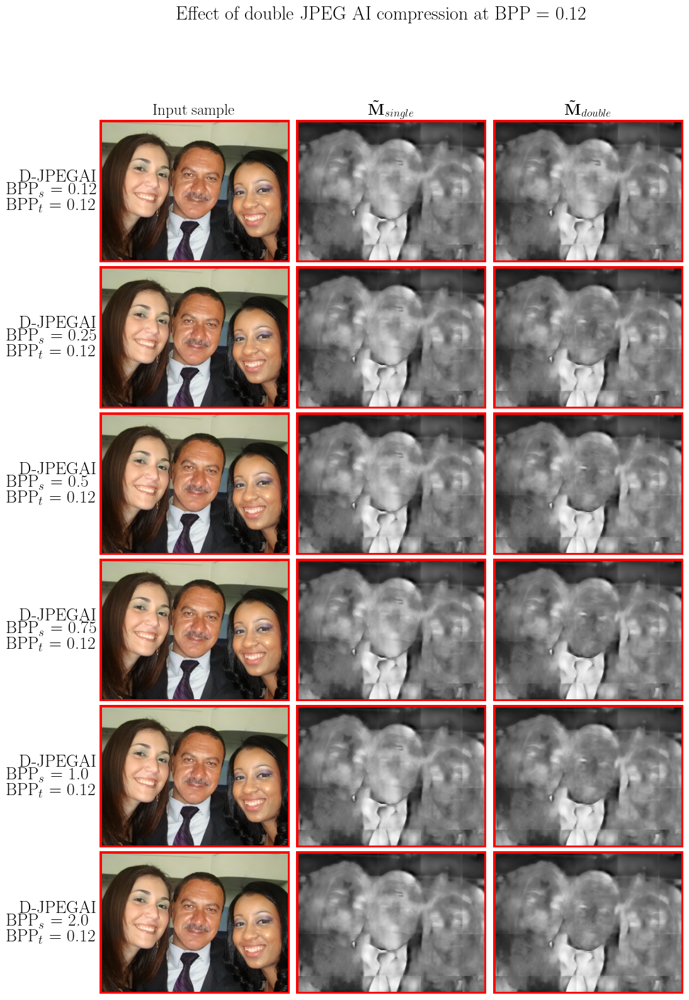

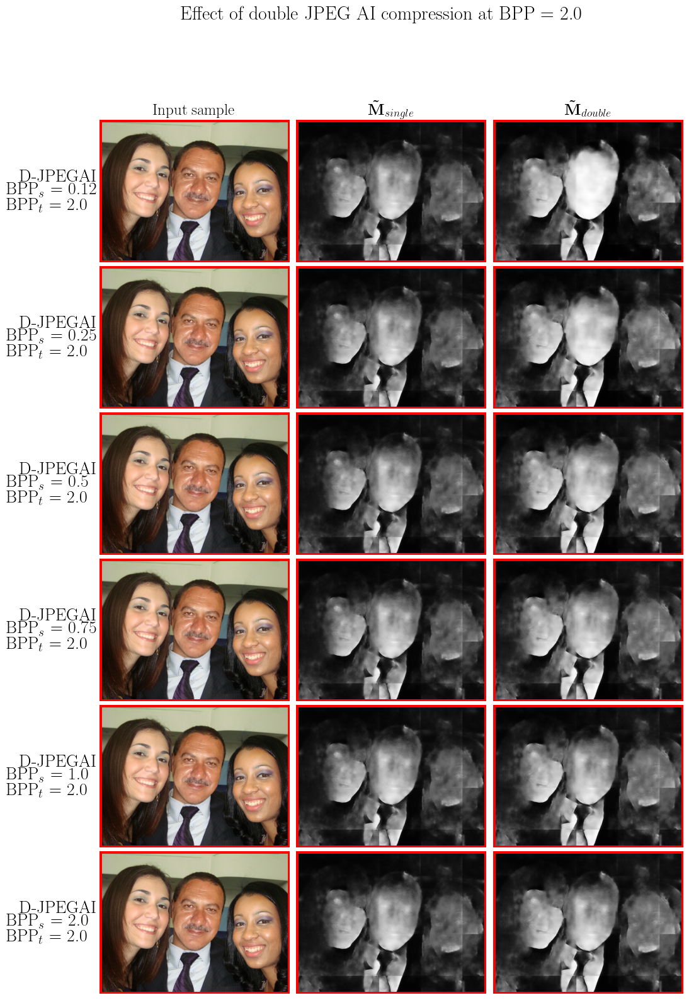

In [16]:
import matplotlib.patches as patches

# Get all the data
unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
djpegai_df = pd.read_csv(os.path.join(results_dir, 'Double JPEGAI', 'results.csv'), index_col=[0, 1])
# Let's add some other columns
djpegai_df['source_bpp'] = djpegai_df['filename'].apply(lambda x: str(float(x.split('_source_bpp-')[1])/100))
djpegai_df['filename'] = djpegai_df['filename'].apply(lambda x: x.split('_source_bpp-')[0])
filename = 'splicing-99'
# Select the sample
samples = djpegai_df.loc[djpegai_df['filename']==filename]

# Cycle over target qualities
for quality in samples['target_bpp'].unique():
    
    # Select the samples
    quality_samples = samples.loc[samples['target_bpp']==quality]
    jpegai_sample = jpegai_df.loc[jpegai_df['filename']==filename]
    jpegai_sample = jpegai_sample.loc[jpegai_sample['target_bpp']==quality]
    
    # Create the figure
    fig, axs = plt.subplots(len(quality_samples['source_bpp'].unique()), 3, figsize=(12, 3*(len(quality_samples['source_bpp'].unique()))))

    # Plot everything
    for idx, bpp in enumerate(['0.12', '0.25', '0.5', '0.75', '1.0', '2.0']):
        # Load sample
        row = quality_samples.loc[quality_samples['source_bpp']==bpp]
        img = Image.open(row.index.values[0][1])
        mask_single = np.load(os.path.join(results_root, jpegai_sample['mask_path'].item()))
        mask = np.load(os.path.join(results_root, row['mask_path'].item()))
        axs[idx][0].imshow(img), axs[idx][1].imshow(mask_single, cmap='gray'), axs[idx][2].imshow(mask, cmap='gray')
        axs[idx][0].axis('off'), axs[idx][1].axis('off'), axs[idx][2].axis('off')

        # Add red contour
        for ax in axs[idx]:
            rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

        # Add text
        axs[idx][0].text(-0.25, 0.5, r'D-JPEGAI\\  BPP$_{s}$ = {bpp}\\ BPP$_{t}$ = {quality}'.format(s='{s}', t='{t}',
                                                                                                     bpp=bpp, quality=quality), 
                         transform=axs[idx][0].transAxes, fontsize=20, va='center', ha='center')
        
    # Add columns names
    axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{\tilde{M}}_{single}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}_{double}$')

    # Load original sample and mask
#     row = unc_df.loc[unc_df['filename']==filename]
#     img = Image.open(row.index.values[0][1])
#     mask = np.load(os.path.join(results_root, row['mask_path'].item()))
#     axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
#     axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
#     axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

#     # Add green contour to the first row
#     for ax in axs[0]:
#         rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
#         ax.add_patch(rect)

#     # Add text to the first row
#     axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

    # Adjust the space between rows 
    #fig.tight_layout()
    fig.suptitle(f'Effect of double JPEG AI compression at BPP = {quality}')
    fig.subplots_adjust(hspace=0.025, wspace=0.025)
    plt.show()


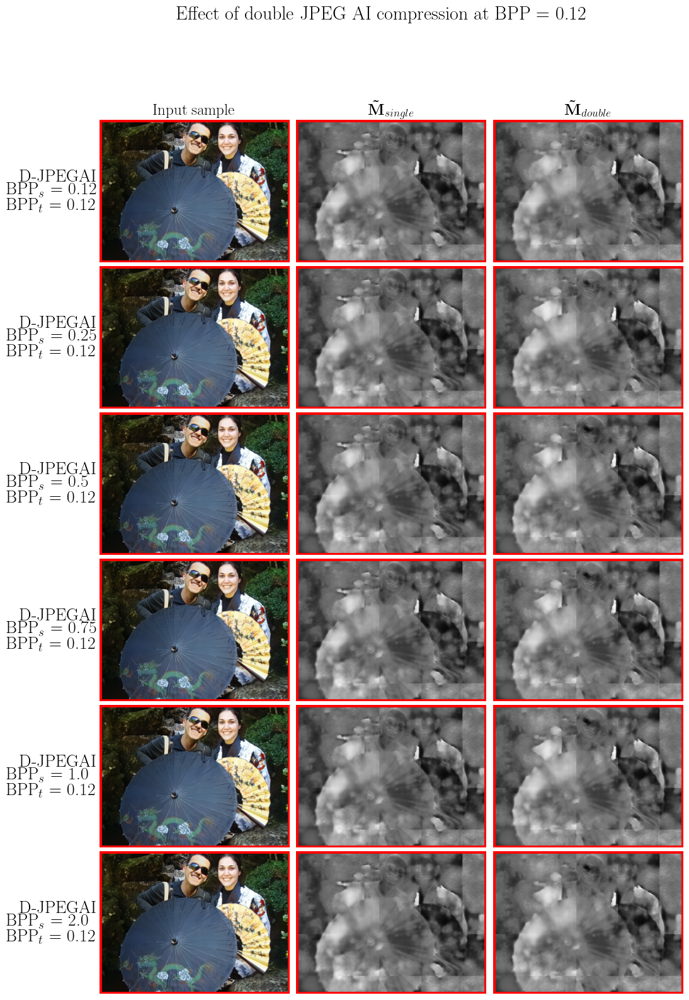

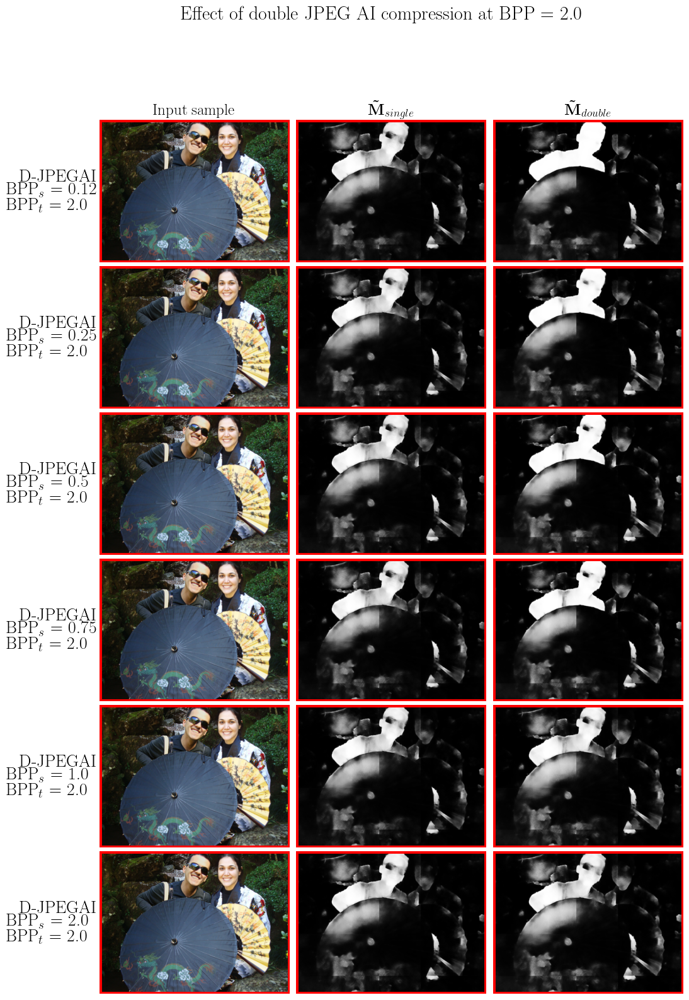

In [17]:
import matplotlib.patches as patches

# Get all the data
unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
djpegai_df = pd.read_csv(os.path.join(results_dir, 'Double JPEGAI', 'results.csv'), index_col=[0, 1])
# Let's add some other columns
djpegai_df['source_bpp'] = djpegai_df['filename'].apply(lambda x: str(float(x.split('_source_bpp-')[1])/100))
djpegai_df['filename'] = djpegai_df['filename'].apply(lambda x: x.split('_source_bpp-')[0])
filename = 'splicing-34'
# Select the sample
samples = djpegai_df.loc[djpegai_df['filename']==filename]

# Cycle over target qualities
for quality in samples['target_bpp'].unique():
    
    # Select the samples
    quality_samples = samples.loc[samples['target_bpp']==quality]
    jpegai_sample = jpegai_df.loc[jpegai_df['filename']==filename]
    jpegai_sample = jpegai_sample.loc[jpegai_sample['target_bpp']==quality]
    
    # Create the figure
    fig, axs = plt.subplots(len(quality_samples['source_bpp'].unique()), 3, figsize=(12, 3*(len(quality_samples['source_bpp'].unique()))))

    # Plot everything
    for idx, bpp in enumerate(['0.12', '0.25', '0.5', '0.75', '1.0', '2.0']):
        # Load sample
        row = quality_samples.loc[quality_samples['source_bpp']==bpp]
        img = Image.open(row.index.values[0][1])
        mask_single = np.load(os.path.join(results_root, jpegai_sample['mask_path'].item()))
        mask = np.load(os.path.join(results_root, row['mask_path'].item()))
        axs[idx][0].imshow(img), axs[idx][1].imshow(mask_single, cmap='gray'), axs[idx][2].imshow(mask, cmap='gray')
        axs[idx][0].axis('off'), axs[idx][1].axis('off'), axs[idx][2].axis('off')

        # Add red contour
        for ax in axs[idx]:
            rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

        # Add text
        axs[idx][0].text(-0.25, 0.5, r'D-JPEGAI\\  BPP$_{s}$ = {bpp}\\ BPP$_{t}$ = {quality}'.format(s='{s}', t='{t}',
                                                                                                     bpp=bpp, quality=quality), 
                         transform=axs[idx][0].transAxes, fontsize=20, va='center', ha='center')
        
    # Add columns names
    axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{\tilde{M}}_{single}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}_{double}$')

    # Load original sample and mask
#     row = unc_df.loc[unc_df['filename']==filename]
#     img = Image.open(row.index.values[0][1])
#     mask = np.load(os.path.join(results_root, row['mask_path'].item()))
#     axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
#     axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
#     axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

#     # Add green contour to the first row
#     for ax in axs[0]:
#         rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
#         ax.add_patch(rect)

#     # Add text to the first row
#     axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

    # Adjust the space between rows 
    #fig.tight_layout()
    fig.suptitle(f'Effect of double JPEG AI compression at BPP = {quality}')
    fig.subplots_adjust(hspace=0.025, wspace=0.025)
    plt.show()


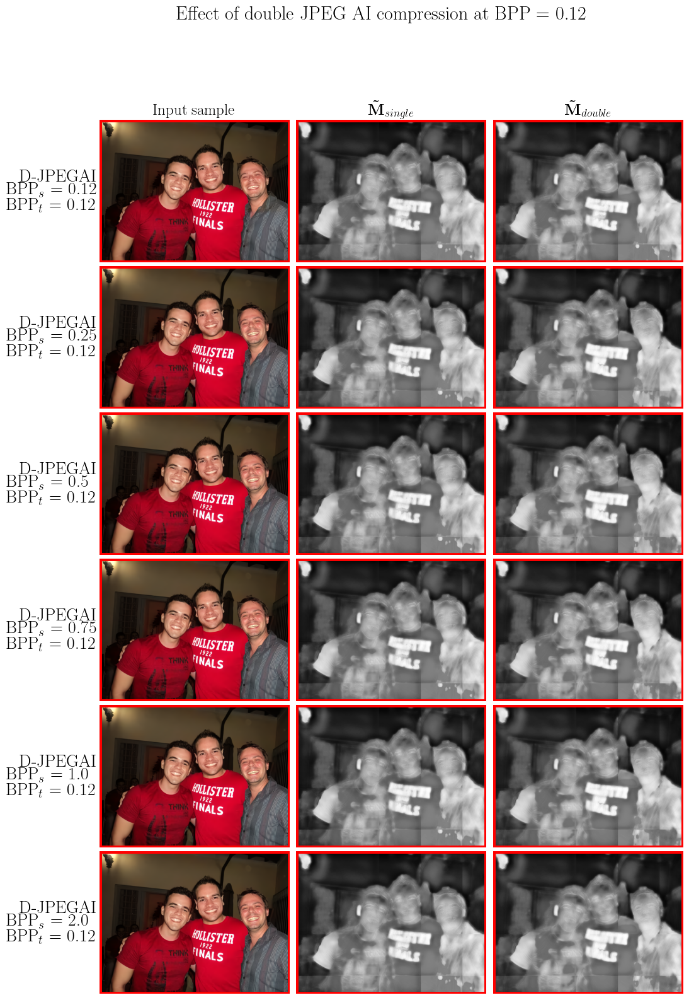

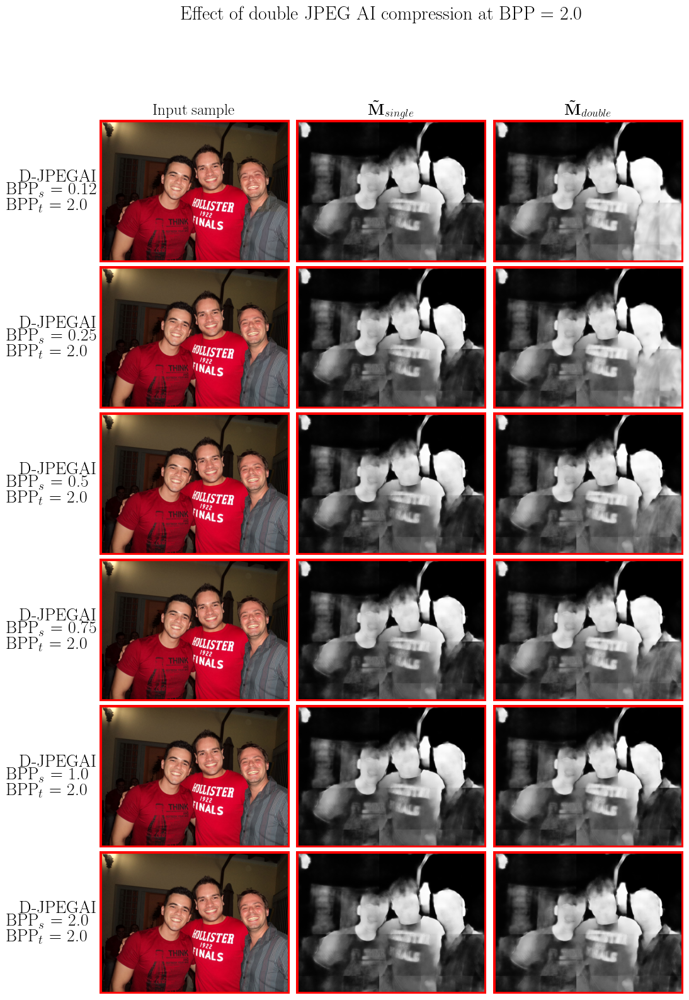

In [18]:
import matplotlib.patches as patches

# Get all the data
unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
djpegai_df = pd.read_csv(os.path.join(results_dir, 'Double JPEGAI', 'results.csv'), index_col=[0, 1])
# Let's add some other columns
djpegai_df['source_bpp'] = djpegai_df['filename'].apply(lambda x: str(float(x.split('_source_bpp-')[1])/100))
djpegai_df['filename'] = djpegai_df['filename'].apply(lambda x: x.split('_source_bpp-')[0])
filename = 'splicing-12'
# Select the sample
samples = djpegai_df.loc[djpegai_df['filename']==filename]

# Cycle over target qualities
for quality in samples['target_bpp'].unique():
    
    # Select the samples
    quality_samples = samples.loc[samples['target_bpp']==quality]
    jpegai_sample = jpegai_df.loc[jpegai_df['filename']==filename]
    jpegai_sample = jpegai_sample.loc[jpegai_sample['target_bpp']==quality]
    
    # Create the figure
    fig, axs = plt.subplots(len(quality_samples['source_bpp'].unique()), 3, figsize=(12, 3*(len(quality_samples['source_bpp'].unique()))))

    # Plot everything
    for idx, bpp in enumerate(['0.12', '0.25', '0.5', '0.75', '1.0', '2.0']):
        # Load sample
        row = quality_samples.loc[quality_samples['source_bpp']==bpp]
        img = Image.open(row.index.values[0][1])
        mask_single = np.load(os.path.join(results_root, jpegai_sample['mask_path'].item()))
        mask = np.load(os.path.join(results_root, row['mask_path'].item()))
        axs[idx][0].imshow(img), axs[idx][1].imshow(mask_single, cmap='gray'), axs[idx][2].imshow(mask, cmap='gray')
        axs[idx][0].axis('off'), axs[idx][1].axis('off'), axs[idx][2].axis('off')

        # Add red contour
        for ax in axs[idx]:
            rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

        # Add text
        axs[idx][0].text(-0.25, 0.5, r'D-JPEGAI\\  BPP$_{s}$ = {bpp}\\ BPP$_{t}$ = {quality}'.format(s='{s}', t='{t}',
                                                                                                     bpp=bpp, quality=quality), 
                         transform=axs[idx][0].transAxes, fontsize=20, va='center', ha='center')
        
    # Add columns names
    axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{\tilde{M}}_{single}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}_{double}$')

    # Load original sample and mask
#     row = unc_df.loc[unc_df['filename']==filename]
#     img = Image.open(row.index.values[0][1])
#     mask = np.load(os.path.join(results_root, row['mask_path'].item()))
#     axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
#     axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
#     axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

#     # Add green contour to the first row
#     for ax in axs[0]:
#         rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
#         ax.add_patch(rect)

#     # Add text to the first row
#     axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

    # Adjust the space between rows 
    #fig.tight_layout()
    fig.suptitle(f'Effect of double JPEG AI compression at BPP = {quality}')
    fig.subplots_adjust(hspace=0.025, wspace=0.025)
    plt.show()


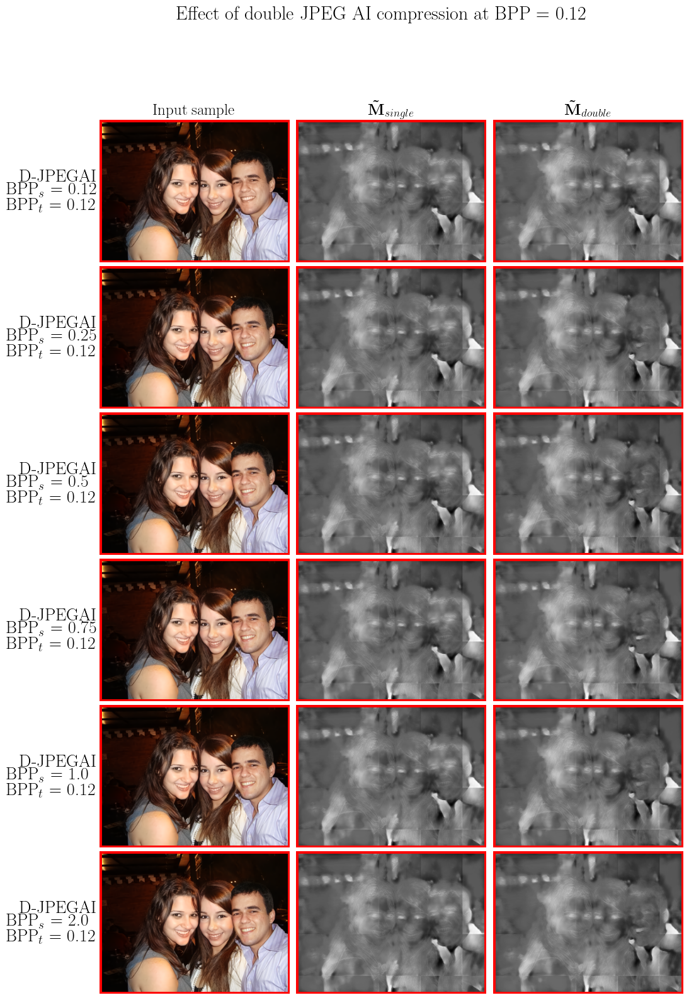

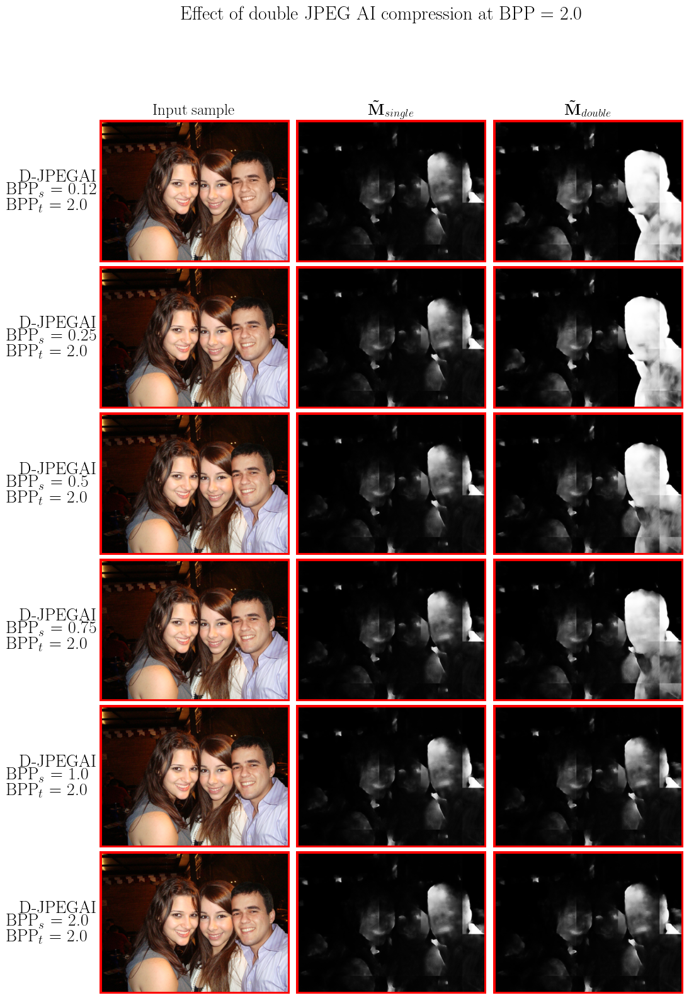

In [19]:
import matplotlib.patches as patches

# Get all the data
unc_df = pd.read_csv(os.path.join(results_dir, 'Uncompressed', 'results.csv'), index_col=[0, 1])
jpegai_df = pd.read_csv(os.path.join(results_dir, 'JPEGAI', 'results.csv'), index_col=[0, 1])
djpegai_df = pd.read_csv(os.path.join(results_dir, 'Double JPEGAI', 'results.csv'), index_col=[0, 1])
# Let's add some other columns
djpegai_df['source_bpp'] = djpegai_df['filename'].apply(lambda x: str(float(x.split('_source_bpp-')[1])/100))
djpegai_df['filename'] = djpegai_df['filename'].apply(lambda x: x.split('_source_bpp-')[0])
filename = 'splicing-71'
# Select the sample
samples = djpegai_df.loc[djpegai_df['filename']==filename]

# Cycle over target qualities
for quality in samples['target_bpp'].unique():
    
    # Select the samples
    quality_samples = samples.loc[samples['target_bpp']==quality]
    jpegai_sample = jpegai_df.loc[jpegai_df['filename']==filename]
    jpegai_sample = jpegai_sample.loc[jpegai_sample['target_bpp']==quality]
    
    # Create the figure
    fig, axs = plt.subplots(len(quality_samples['source_bpp'].unique()), 3, figsize=(12, 3*(len(quality_samples['source_bpp'].unique()))))

    # Plot everything
    for idx, bpp in enumerate(['0.12', '0.25', '0.5', '0.75', '1.0', '2.0']):
        # Load sample
        row = quality_samples.loc[quality_samples['source_bpp']==bpp]
        img = Image.open(row.index.values[0][1])
        mask_single = np.load(os.path.join(results_root, jpegai_sample['mask_path'].item()))
        mask = np.load(os.path.join(results_root, row['mask_path'].item()))
        axs[idx][0].imshow(img), axs[idx][1].imshow(mask_single, cmap='gray'), axs[idx][2].imshow(mask, cmap='gray')
        axs[idx][0].axis('off'), axs[idx][1].axis('off'), axs[idx][2].axis('off')

        # Add red contour
        for ax in axs[idx]:
            rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

        # Add text
        axs[idx][0].text(-0.25, 0.5, r'D-JPEGAI\\  BPP$_{s}$ = {bpp}\\ BPP$_{t}$ = {quality}'.format(s='{s}', t='{t}',
                                                                                                     bpp=bpp, quality=quality), 
                         transform=axs[idx][0].transAxes, fontsize=20, va='center', ha='center')
        
    # Add columns names
    axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{\tilde{M}}_{single}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}_{double}$')

    # Load original sample and mask
#     row = unc_df.loc[unc_df['filename']==filename]
#     img = Image.open(row.index.values[0][1])
#     mask = np.load(os.path.join(results_root, row['mask_path'].item()))
#     axs[0][0].imshow(img), axs[0][1].imshow(gt, cmap='gray'), axs[0][2].imshow(mask, cmap='gray')
#     axs[0][0].set_title('Input sample'), axs[0][1].set_title(r'$\mathbf{M}$'), axs[0][2].set_title(r'$\mathbf{\tilde{M}}$')
#     axs[0][0].axis('off'), axs[0][1].axis('off'), axs[0][2].axis('off')

#     # Add green contour to the first row
#     for ax in axs[0]:
#         rect = patches.Rectangle((0, 0), img.size[0], img.size[1], linewidth=5, edgecolor='g', facecolor='none')
#         ax.add_patch(rect)

#     # Add text to the first row
#     axs[0][0].text(-0.2, 0.5, 'Original\n format', transform=axs[0][0].transAxes, fontsize=20, va='center', ha='center')

    # Adjust the space between rows 
    #fig.tight_layout()
    fig.suptitle(f'Effect of double JPEG AI compression at BPP = {quality}')
    fig.subplots_adjust(hspace=0.025, wspace=0.025)
    plt.show()
